## Loading the data

In [1]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd
sc.set_figure_params(dpi=300, frameon=False)
sc.logging.print_header()

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


scanpy==1.6.0 anndata==0.7.4 umap==0.4.6 numpy==1.19.2 scipy==1.6.1 pandas==1.2.3 scikit-learn==0.23.2 statsmodels==0.11.1 python-igraph==0.8.3 leidenalg==0.8.3


In [2]:
%load_ext autoreload
%autoreload 2

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [3]:
import os
os.chdir('./../')

In [4]:
# adata = sc.read('datasets/sciplex3_new.h5ad')
adata = sc.read('datasets/sciplex3_old_reproduced.h5ad')

## Look at data

In [5]:
import pandas as pd
pd.crosstab(adata.obs['split'], adata.obs['condition'])

condition,2-Methoxyestradiol,A-366,ABT-737,AC480,AG-490,AG-14361,AICAR,AMG-900,AR-42,AT9283,...,Valproic,Vandetanib,Veliparib,WHI-P154,WP1066,XAV-939,ZM,Zileuton,control,nan
split,,,,,,,,,,,,,,,,,,,,,
ood,0,0,0,0,0,355,0,0,0,0,...,0,0,0,0,0,249,0,403,0,0
test,146,174,137,180,158,129,183,145,135,101,...,182,137,166,176,197,120,136,128,648,275
train,1341,1507,1257,1475,1590,1170,1640,1191,1271,809,...,1622,1230,1431,1588,1654,1057,1258,1197,5816,2561


## Loading the model

In [7]:
import torch
from cpa.train import prepare_cpa

state, args, history = torch.load(
#     '/home/icb/yuge.ji/projects/test_AdvAE/sweep_sciplex3_new_model_seed=93_epoch=141.pt',
#     '/home/icb/yuge.ji/projects/test_AdvAE/sweep_sciplex3_new_logsigm_model_seed=30_epoch=140.pt',
#     '/home/icb/yuge.ji/projects/test_AdvAE/sweep_sciplex3_old_logsigm_model_seed=30_epoch=120.pt',
#     '/home/icb/yuge.ji/projects/test_AdvAE/sweep_sciplex3_old_model_seed=30_epoch=120.pt',
    'pretrained_models/sweep_sciplex3_old_reproduced_logsigm_model_seed=30_epoch=340.pt',
#     'sweep_sciplex3_old_reproduced_sigm_model_seed=30_epoch=160.pt',
#     'ckpts_sciplex/model_seed=30_epoch=380.pt',
    map_location=torch.device('cpu'))

# load the dataset and model pre-trained weights
model, datasets = prepare_cpa(args, state_dict=state)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [6]:
args

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'dataset_path': 'datasets/sciplex3_old_reproduced.h5ad',
 'perturbation_key': 'condition',
 'dose_key': 'dose_val',
 'cell_type_key': 'cell_type',
 'split_key': 'split',
 'loss_ae': 'gauss',
 'doser_type': 'logsigm',
 'decoder_activation': 'linear',
 'seed': 30,
 'hparams': '',
 'max_epochs': 2000,
 'max_minutes': 3000,
 'patience': 20,
 'checkpoint_freq': 20,
 'save_dir': '/checkpoint/dlp/sweep_sciplex3_old_reproduced_logsigm',
 'sweep_seeds': 200}

In [7]:
model.hparams  # current model

{'dim': 256,
 'dosers_width': 64,
 'dosers_depth': 2,
 'dosers_lr': 0.00027322083000748615,
 'dosers_wd': 1.6901978814494262e-07,
 'autoencoder_width': 1024,
 'autoencoder_depth': 4,
 'adversary_width': 128,
 'adversary_depth': 4,
 'reg_adversary': 92.68382940512102,
 'penalty_adversary': 0.05071935089473691,
 'autoencoder_lr': 0.0014838449980044868,
 'adversary_lr': 6.506990958061247e-05,
 'autoencoder_wd': 3.507012291996189e-08,
 'adversary_wd': 4.289521637980284e-05,
 'adversary_steps': 5,
 'batch_size': 256,
 'step_size_lr': 15}

In [8]:
# old model
# model.hparams

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'dim': 256,
 'dosers_width': 64,
 'dosers_depth': 2,
 'dosers_lr': 0.00027322083000748615,
 'dosers_wd': 1.6901978814494262e-07,
 'autoencoder_width': 1024,
 'autoencoder_depth': 4,
 'adversary_width': 128,
 'adversary_depth': 4,
 'reg_adversary': 92.68382940512102,
 'penalty_adversary': 0.05071935089473691,
 'autoencoder_lr': 0.0014838449980044868,
 'adversary_lr': 6.506990958061247e-05,
 'autoencoder_wd': 3.507012291996189e-08,
 'adversary_wd': 4.289521637980284e-05,
 'adversary_steps': 5,
 'batch_size': 256,
 'step_size_lr': 15}

In [8]:
from cpa.plotting import CompertVisuals
from cpa.api import ComPertAPI

In [9]:
cpa_api = ComPertAPI(datasets, model)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Evaluate performance

In [19]:
# %%time
# from cpa.train import evaluate

# res = evaluate(model, datasets)
# res

CPU times: user 2h 51min 42s, sys: 23min 46s, total: 3h 15min 29s
Wall time: 18min 48s


{'training': [0.9565123761228167,
  -140.24163395229988,
  0.890903296297449,
  -811.9318646394692],
 'test': [0.9669945308558275,
  -15.244148998947852,
  0.8757581665700661,
  -275.47737698742924],
 'ood': [0.958100115958487,
  -191.76823258343353,
  0.9006524318282488,
  -714.0726140271927],
 'perturbation disentanglement': 0.010452321625105246,
 'optimal for perturbations': 0.005405405405405406,
 'covariate disentanglement': 0.3371151743924099,
 'optimal for covariates': 0.3333333333333333}

In [11]:
# construct prediction annadata
subset = adata[adata.obs[args['cell_type_key']] == 'A549'].copy()
genes_control = subset[subset.obs[args['perturbation_key']] == 'control'].copy()

df = pd.DataFrame({args['perturbation_key']: adata.obs[args['perturbation_key']].unique()[:20], 
                   args['dose_key']: ['1.0']*20, 
                   args['cell_type_key']: ['A549']*10 + ['MCF7']*10})

pred = cpa_api.predict(genes_control.X.toarray(), df, return_anndata=True)  # normally would put `sample=True` here
pred.obs['cov_drug_dose_name'] = \
    pred.obs['cell_type'].astype(str) + '_' + pred.obs['condition'].astype(str) + '_' + pred.obs['dose_val'].astype(str)
pred.obs['cov_drug_dose_name'] = pred.obs['cov_drug_dose_name'].astype('category')
pred

AnnData expects .obs.index to contain strings, but your first indices are: Int64Index([0, 1], dtype='int64'), …


AnnData object with n_obs × n_vars = 33360 × 5000
    obs: 'condition', 'dose_val', 'cell_type', 'uncertainty_cosine', 'uncertainty_euclidean', 'closest_cond_cosine', 'closest_cond_euclidean', 'cov_drug_dose_name'
    layers: 'variance'

Calculate R2 between predicted categories.

In [12]:
de_dict = datasets['training'].de_genes
de_dict = {k: adata.var_names for k, v in de_dict.items()}

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


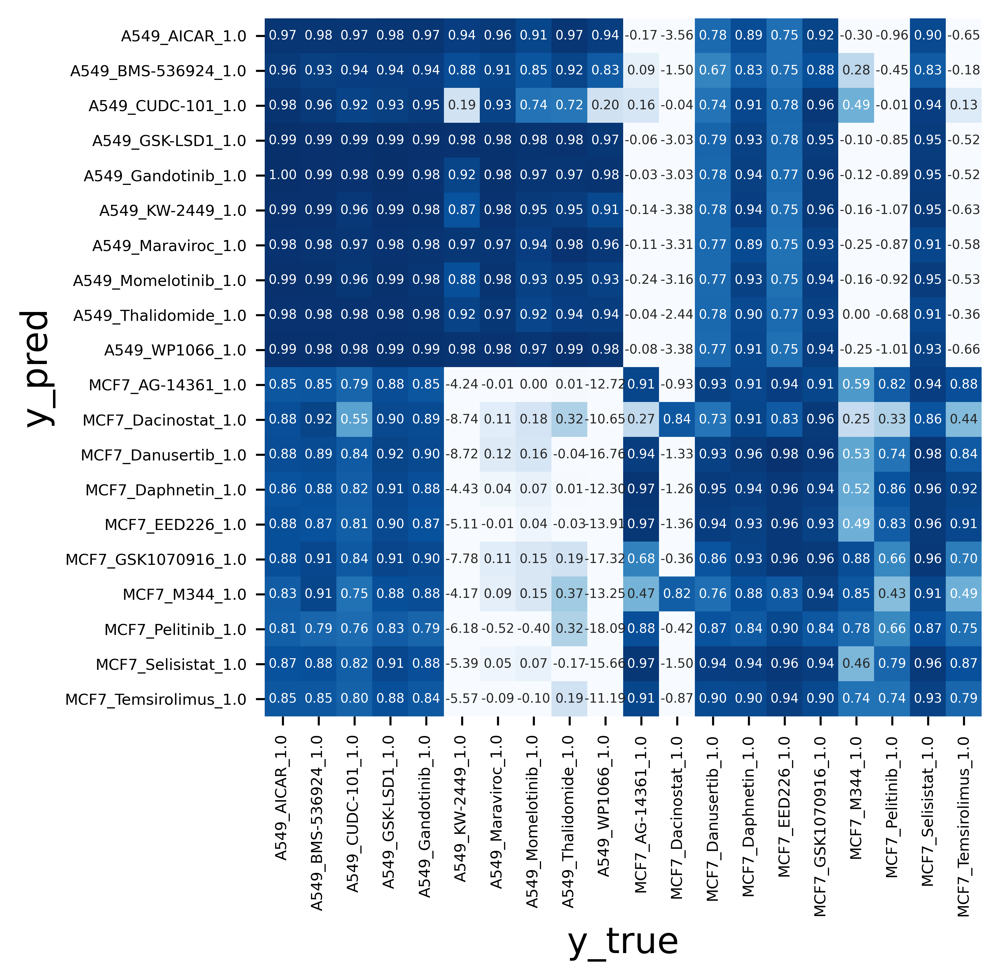

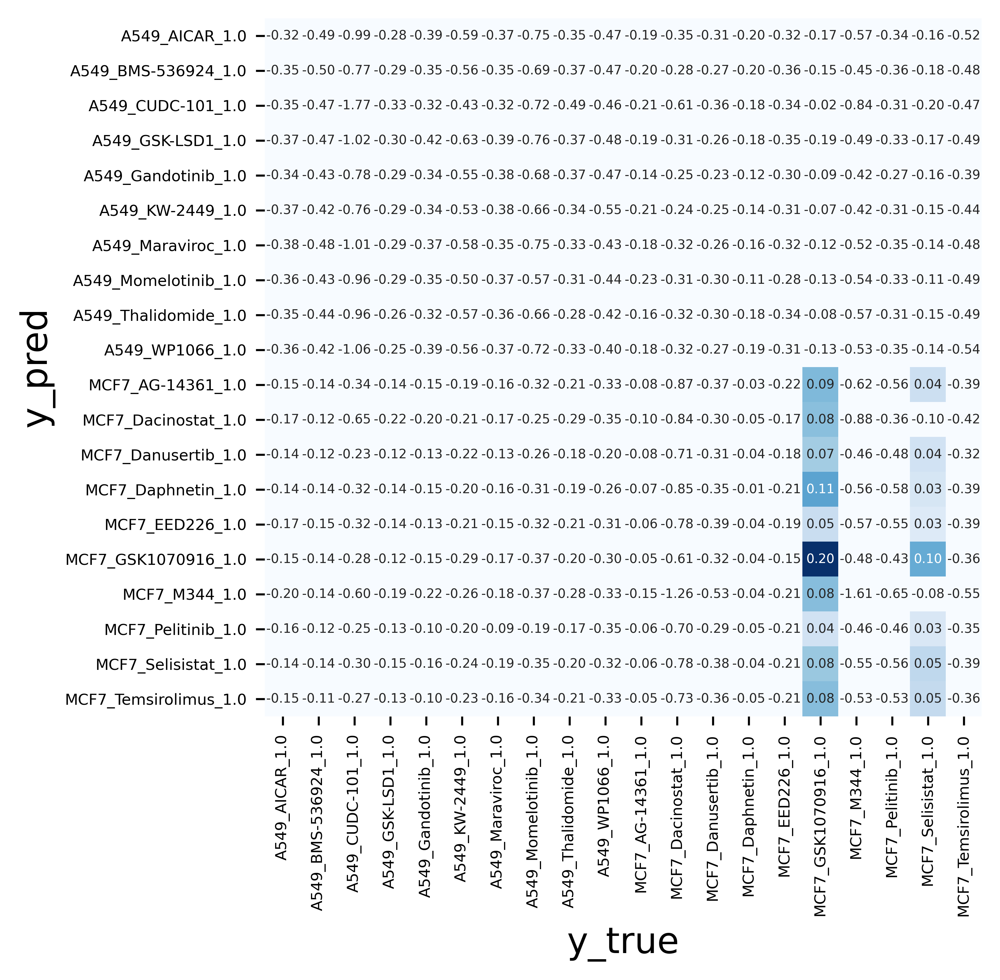

In [13]:
from cpa.plotting import plot_r2_matrix
plot_r2_matrix(pred, adata, datasets['training'].de_genes)

#### On the real data:

In [52]:
adata.X = adata.X.toarray()

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


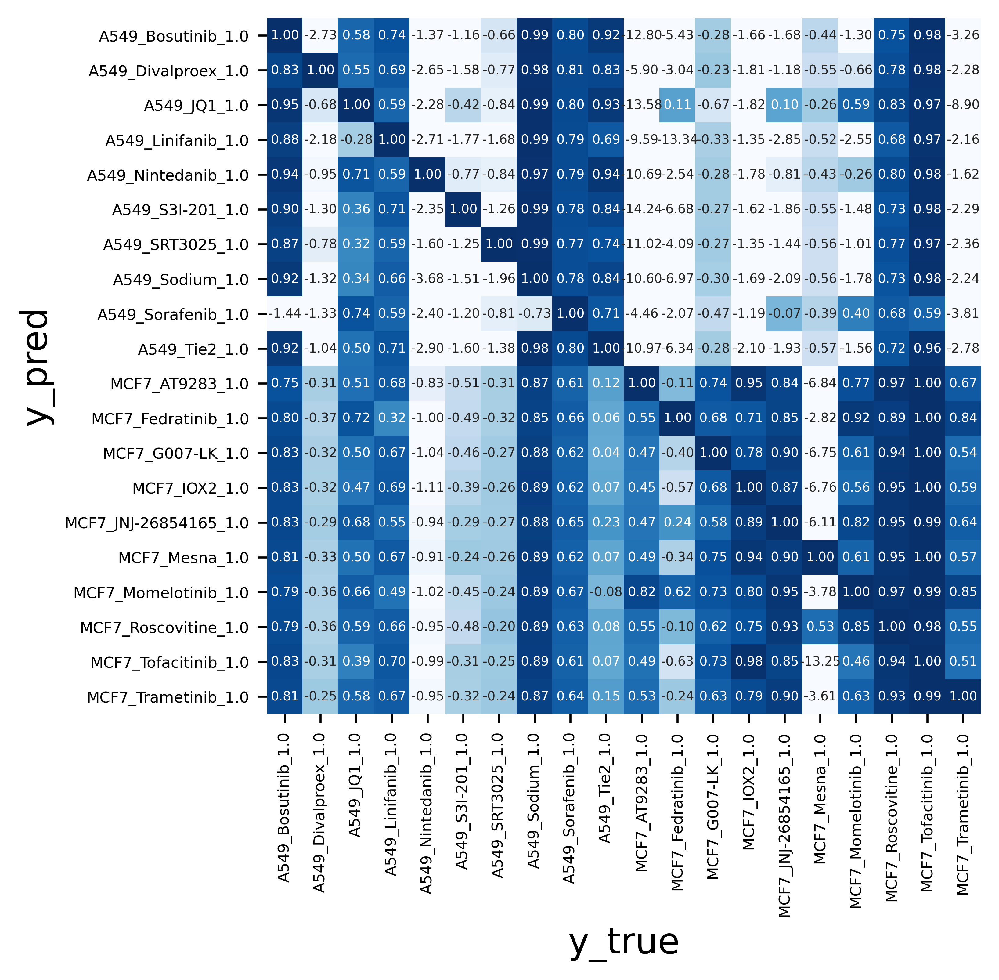

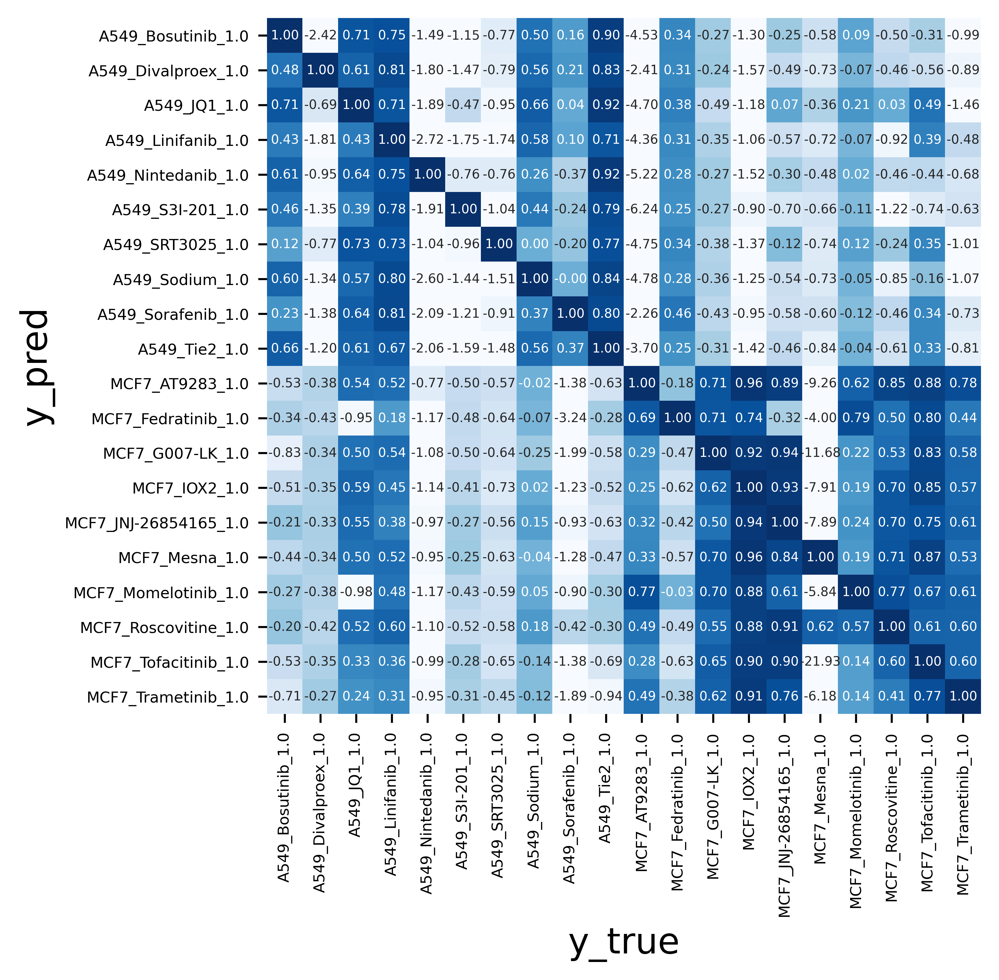

In [54]:
plot_r2_matrix(
    adata[adata.obs.cov_drug_dose_name.isin(pred.obs.cov_drug_dose_name.unique())],
    adata, datasets['training'].de_genes)

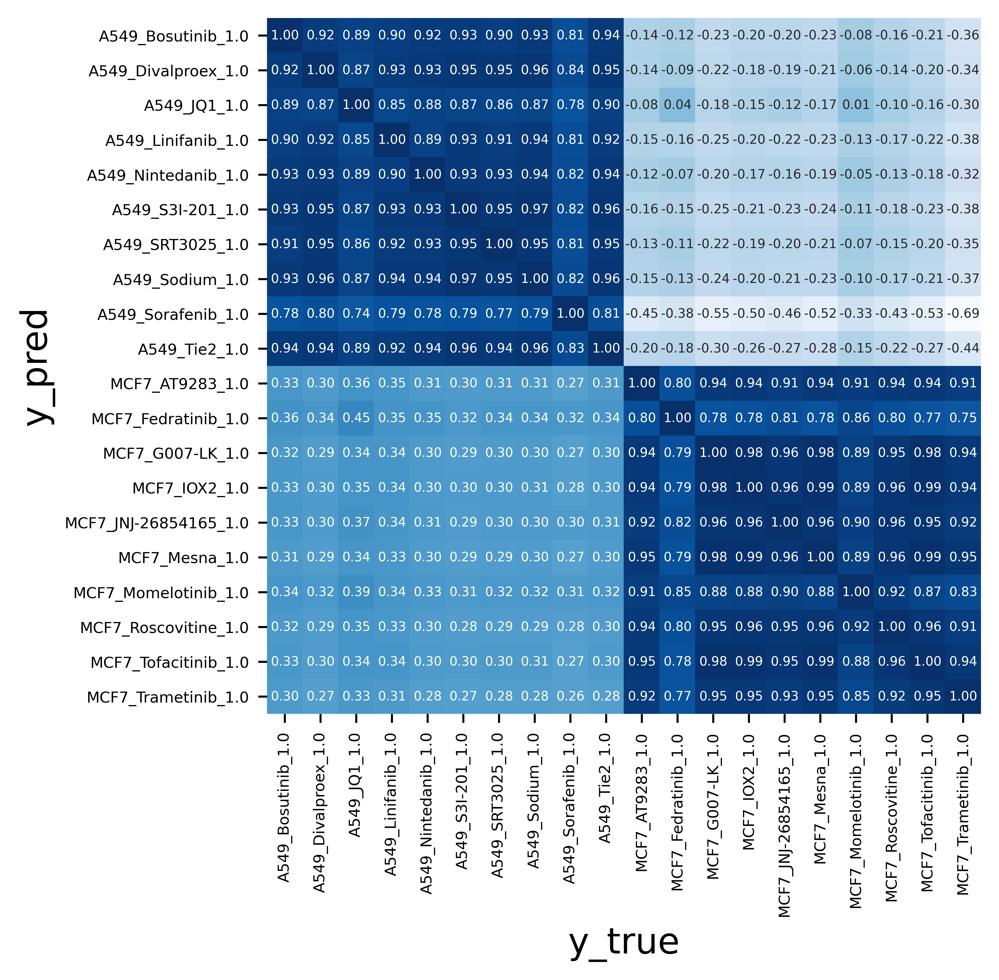

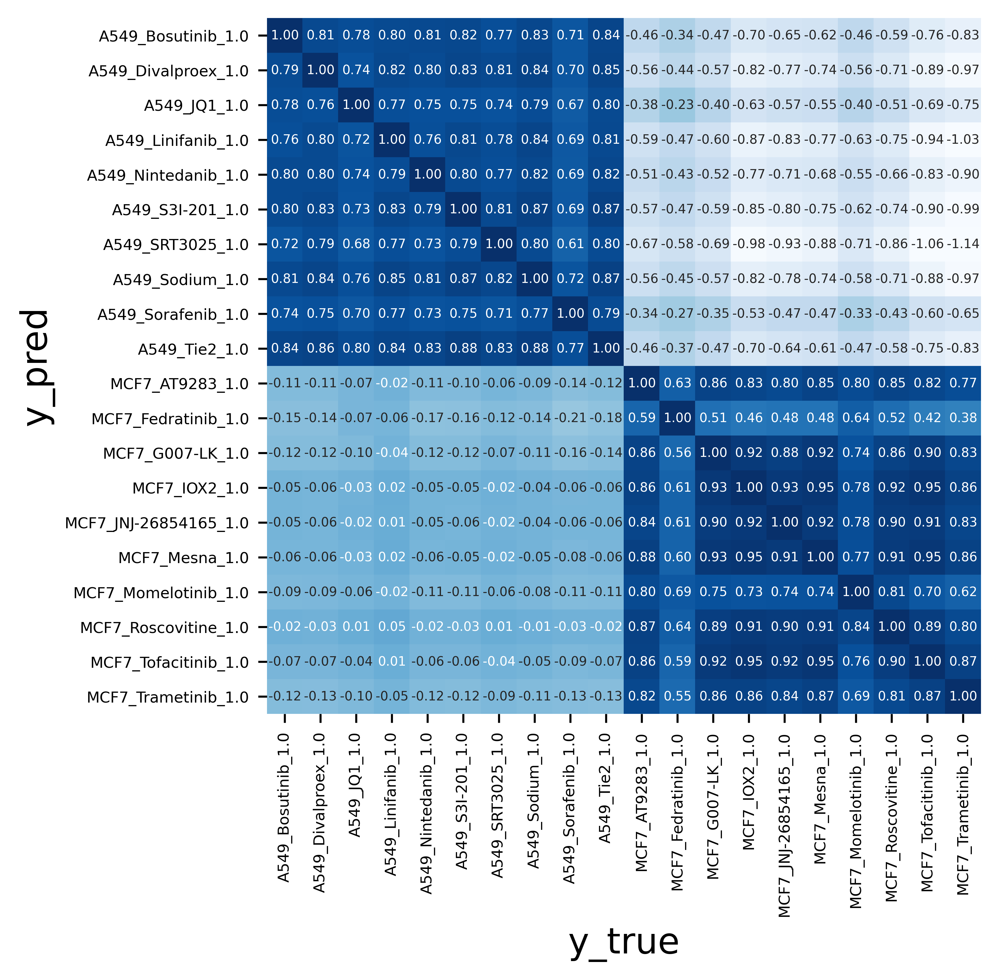

In [53]:
plot_r2_matrix(
    adata[adata.obs.cov_drug_dose_name.isin(pred.obs.cov_drug_dose_name.unique())],
    adata, de_dict)

We should see a strong diagonal in a good model.

#### Plot example condition

In [12]:
pred_adata = pred.concatenate(adata, batch_key='source', batch_categories=['pred', 'true'])

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1210: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'condition' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'dose_val' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cell_type' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'closest_cond_cosine' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'closest_cond_euclidean' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'dose_character' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'dose_pattern' as categorical
Trying to set attribute `.obs` of view,

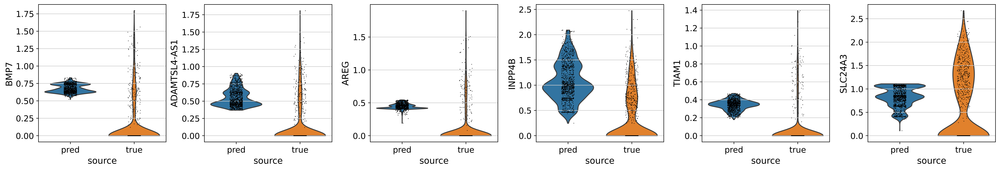

In [13]:
sc.pl.violin(
    pred_adata[pred_adata.obs.condition == 'Trametinib'],
    keys=datasets['training'].de_genes['MCF7_Trametinib_1.0'][:6],
    groupby='source')

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
Trying to set attribute `.uns` of view, copying.


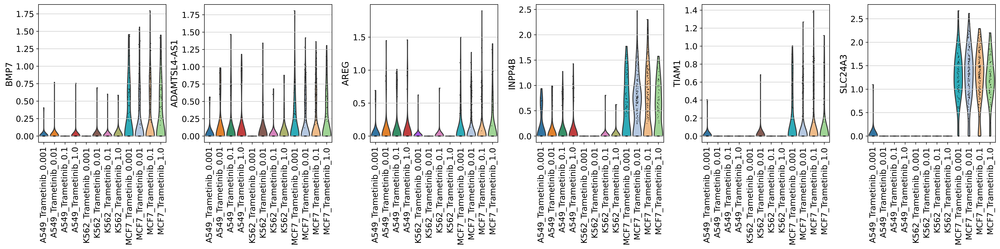

In [14]:
sc.pl.violin(
    adata[adata.obs.condition == 'Trametinib'],
    keys=datasets['training'].de_genes['MCF7_Trametinib_1.0'][:6],
    groupby='cov_drug_dose_name', rotation=90)

## Plotting learned embeddings

Currently we need to provide the whole dataset to initialize the API. Parameter 'return_dataset=True' in load_dataset_splits() will return this full dataset in the correct format.

Print and plot drug embeddings.

In [29]:
covars_anndata = cpa_api.get_covars_embeddings()
perts_anndata = cpa_api.get_drug_embeddings()
perts_anndata.obs['MoA'] = perts_anndata.obs.condition.map(
    dict(zip(adata.obs.condition.values, adata.obs.pathway_level_1.values))
)
latent_response = cpa_api.latent_dose_response()

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [30]:
# multiply by per compound dose response
for cond in perts_anndata.obs.condition.unique():
    perts_anndata[perts_anndata.obs.condition == cond].X *= latent_response[(latent_response.condition == 'Barasertib') & (latent_response.dose_val == 1.0)].response.values[0]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
... storing 'MoA' as categorical


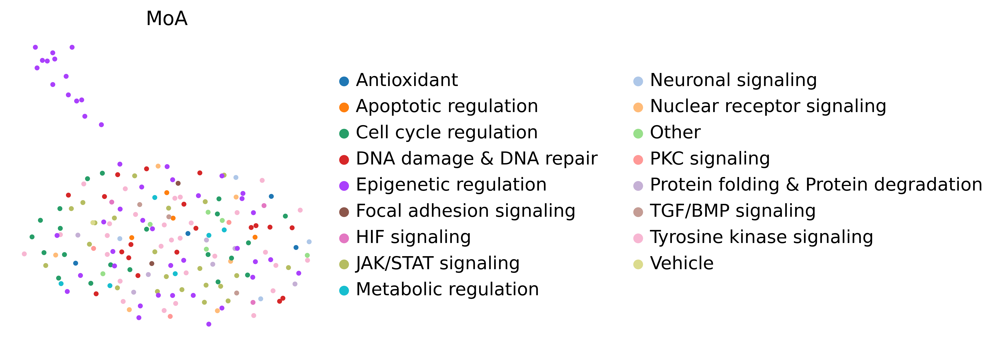

... storing 'MoA' as categorical


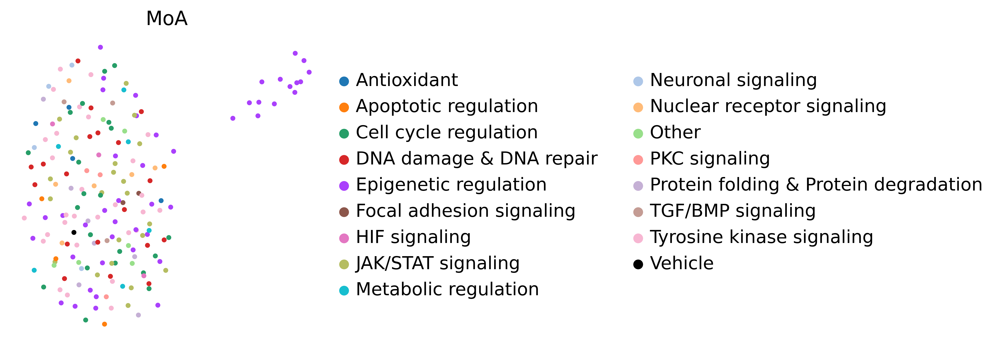

... storing 'MoA' as categorical


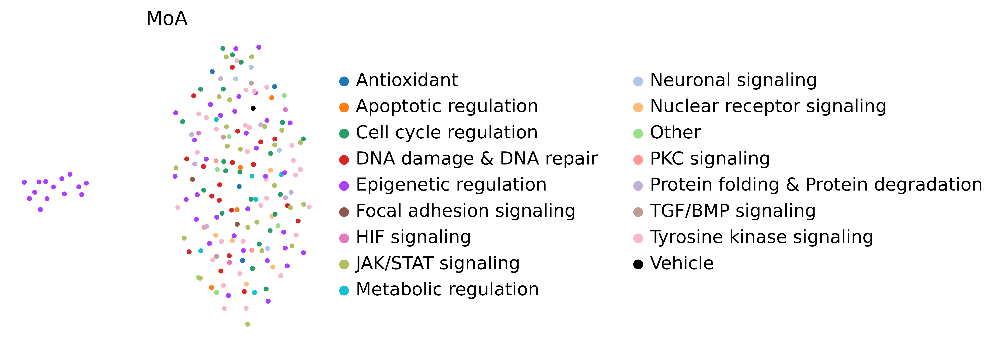

In [31]:
ct_adatas = []
for i in range(3):
    perts_ct = perts_anndata.copy()

    perts_ct.X = perts_ct.X + covars_anndata.X[i]
    ct_adatas.append(perts_ct)

    sc.pp.neighbors(perts_ct, n_neighbors=12, use_rep='X', metric='cosine')
    sc.tl.umap(perts_ct)

    sc.pl.umap(perts_ct, color='MoA', size=50)
#     perts_anndata.uns['MoA_colors'] = perts_ct.uns['MoA_colors'][:-1] + ['#000000']  # make "Vehicle" black
    # sc.pl.umap(perts_anndata, color='MoA', size=50)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
... storing 'condition' as categorical


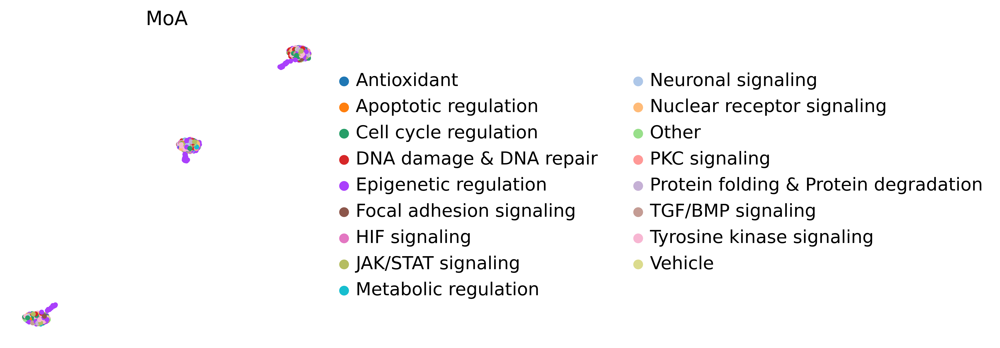

In [33]:
# plot them all on the same UMAP
all_ct = ct_adatas[0].concatenate(ct_adatas[1:])
sc.pp.neighbors(all_ct, n_neighbors=12, use_rep='X', metric='cosine')
sc.tl.umap(all_ct)
sc.pl.umap(all_ct, color='MoA', size=50)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


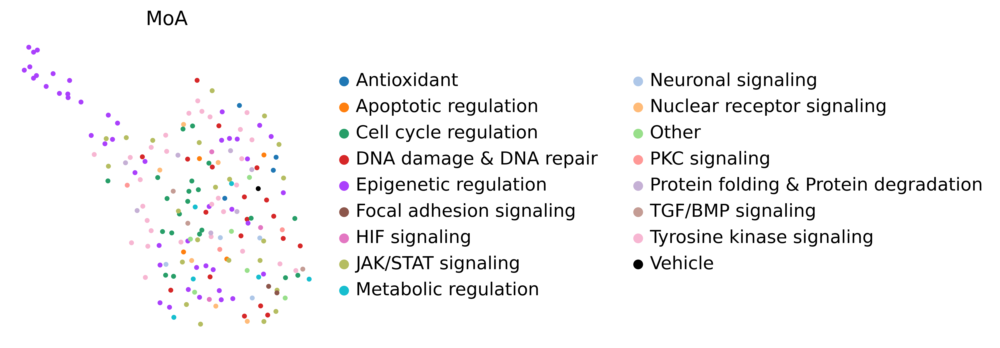

In [42]:
sc.pp.neighbors(perts_anndata, n_neighbors=9, use_rep='X')
sc.tl.umap(perts_anndata)

sc.pl.umap(perts_anndata, color='MoA', size=50)
perts_anndata.uns['MoA_colors'] = perts_anndata.uns['MoA_colors'][:-1] + ['#000000']  # make "Vehicle" black

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


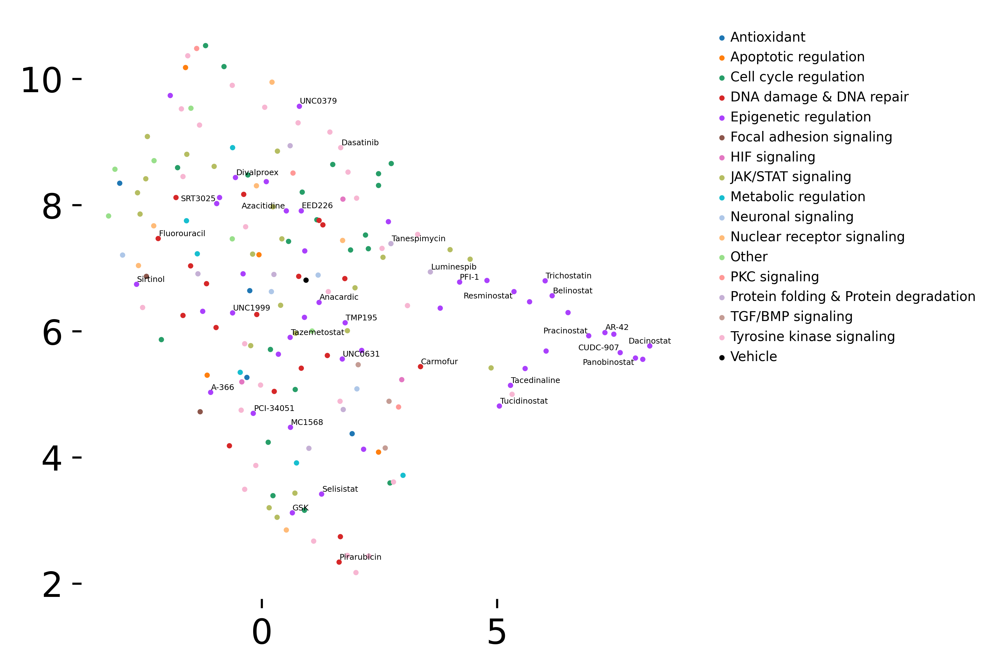

In [33]:
from adjustText import adjust_text

cmpds = [
    'Dacinostat', 'UNC0379', 'Pracinostat', 'UNC1999', 'Sirtinol',
    'TMP195', 'GSK', 'PCI-34051', 'Tacedinaline',
    'EED226', 'Tucidinostat', 'PFI-1', 'CUDC-907', 'Selisistat',
    'Anacardic', 'Azacitidine', 'AR-42', 'Belinostat',
    'Tazemetostat', 'SRT3025', 'Trichostatin', 'SRT1720', 'Panobinostat', 'UNC0631',
    'A-366', 'Divalproex', 'Resminostat', 'MC1568', 'Vehicle',
    # non epi
    'Dasatinib', 'Carmofur', 'Ralitraxed', 'Fluorouracil', 'Pirarubicin', 
    # protein
    'Luminespib', 'Tanespimycin', 'Alvespimycin']
for i, moa in enumerate(perts_anndata.obs.MoA.cat.categories):
    subset = perts_anndata[perts_anndata.obs.MoA == moa].copy()
    x = subset.obsm['X_umap'].T[0]
    y = subset.obsm['X_umap'].T[1]
    plt.scatter(x, y, label=moa, color=perts_anndata.uns['MoA_colors'][i], s=1)
    
# plot texts
x = perts_anndata.obsm['X_umap'].T[0]
y = perts_anndata.obsm['X_umap'].T[1]
texts = [plt.text(x[i], y[i], f'{perts_anndata.obs.condition.values[i]}', size=3) for i in range(len(x)) if perts_anndata.obs.condition.values[i] in cmpds]
adjust_text(texts)
plt.grid(b=None)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=5, frameon=False)
# plt.tick_params(top='off', bottom='off', left='off', right='off', labelleft='off', labelbottom='off')
plt.box(False)
plt.show();

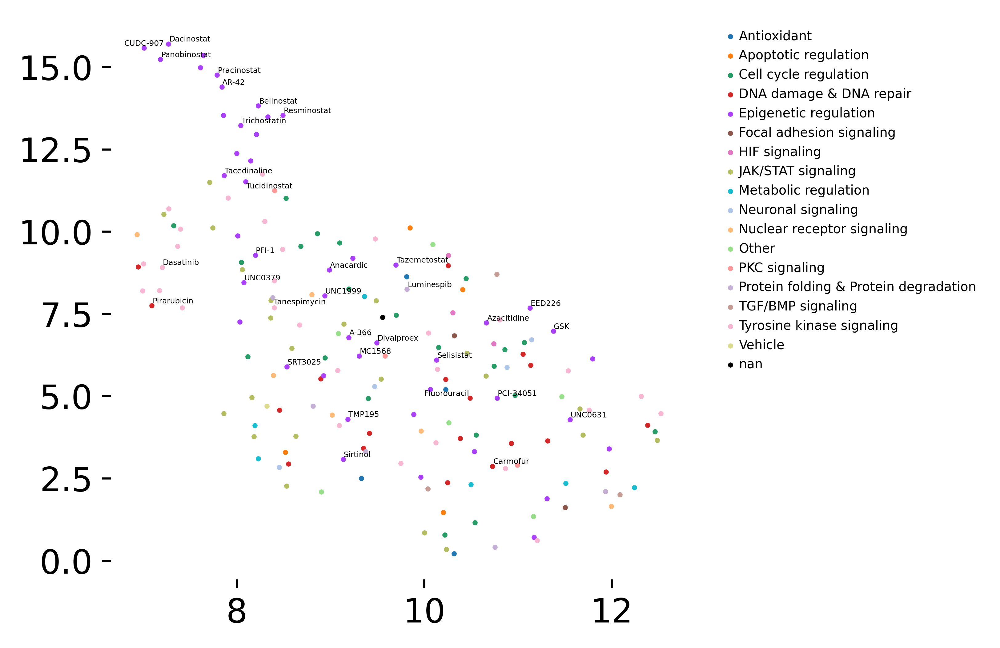

In [29]:
from adjustText import adjust_text

cmpds = [
    'Dacinostat', 'UNC0379', 'Pracinostat', 'UNC1999', 'Sirtinol',
    'TMP195', 'GSK', 'PCI-34051', 'Tacedinaline',
    'EED226', 'Tucidinostat', 'PFI-1', 'CUDC-907', 'Selisistat',
    'Anacardic', 'Azacitidine', 'AR-42', 'Belinostat',
    'Tazemetostat', 'SRT3025', 'Trichostatin', 'SRT1720', 'Panobinostat', 'UNC0631',
    'A-366', 'Divalproex', 'Resminostat', 'MC1568', 'Vehicle',
    # non epi
    'Dasatinib', 'Carmofur', 'Ralitraxed', 'Fluorouracil', 'Pirarubicin', 
    # protein
    'Luminespib', 'Tanespimycin', 'Alvespimycin']
for i, moa in enumerate(perts_anndata.obs.MoA.cat.categories):
    subset = perts_anndata[perts_anndata.obs.MoA == moa].copy()
    x = subset.obsm['X_umap'].T[0]
    y = subset.obsm['X_umap'].T[1]
    plt.scatter(x, y, label=moa, color=perts_anndata.uns['MoA_colors'][i], s=1)
    
# plot texts
x = perts_anndata.obsm['X_umap'].T[0]
y = perts_anndata.obsm['X_umap'].T[1]
texts = [plt.text(x[i], y[i], f'{perts_anndata.obs.condition.values[i]}', size=3) for i in range(len(x)) if perts_anndata.obs.condition.values[i] in cmpds]
adjust_text(texts)
plt.grid(b=None)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=5, frameon=False)
# plt.tick_params(top='off', bottom='off', left='off', right='off', labelleft='off', labelbottom='off')
plt.box(False)
plt.show();

Setting up a variabel for automatic plotting. The plots also could be used separately.

In [36]:
cpa_plots = CompertVisuals(cpa_api, fileprefix=None)

In [37]:
# cpa_plots.plot_latent_embeddings(cpa_api.emb_perts, show_text=False)

In [38]:
color_dict = dict(zip(
    perts_anndata.obs.condition.values,
    perts_anndata.obs['condition'].map(
        dict(zip(perts_anndata.obs.condition.values, perts_anndata.obs.MoA.values))
    ).map(
        dict(zip(perts_anndata.obs.MoA.cat.categories, perts_anndata.uns['MoA_colors']))
    )
))

In [39]:
latent_response = cpa_api.latent_dose_response()
cpa_plots.plot_contvar_response(
    latent_response, 
    postfix='latent',
    var_name=cpa_api.perturbation_key,
    title_name='Latent dose response',
    palette=color_dict)
plt.legend(bbox_to_anchor=(2.0, 2.0))

/home/icb/yuge.ji/projects/test_AdvAE/cpa/plotting.py:602: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  fig.tight_layout()


In [40]:
%%time
df_reference = cpa_api.get_response_reference(datasets, perturbations=['Ofloxacin', 'Dacinostat', 'Panobinostat'])        
reconstructed_response = cpa_api.get_response(datasets, perturbations=['Ofloxacin', 'Dacinostat', 'Panobinostat'])

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


CPU times: user 1h 31min 22s, sys: 2min 12s, total: 1h 33min 35s
Wall time: 4min 26s


In [41]:
reconstructed_response['source'] = 'pred'
df_reference['source'] = 'true'

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [42]:
import seaborn as sns

Text(0.5, 1.0, 'real vs. predicted response to 3 cmpds in A549')

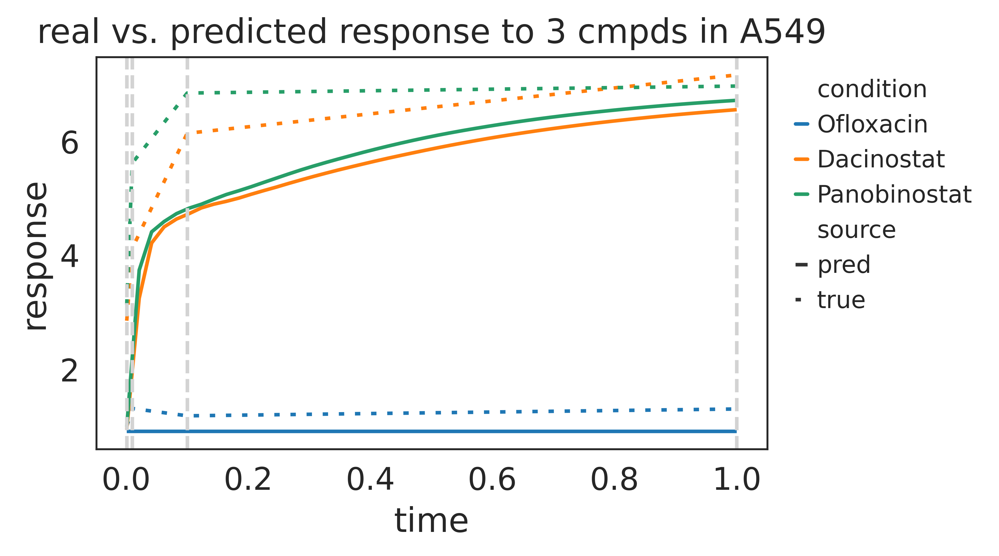

In [43]:
plt.figure(figsize=(5, 3))
data = pd.concat([reconstructed_response, df_reference])
sns.lineplot(
    data=data[data.cell_type == 'A549'],
    x='dose_val',
    y='response',
    hue='condition', 
    style='source', dashes=[(1, 0), (1.5, 3)])
plt.legend(bbox_to_anchor=(1.01, 1), loc='upper left', fontsize=10, frameon=False)

# lines for measured time
for val in df_reference.dose_val.unique():
    plt.axvline(val, color='lightgrey', linestyle='--')
plt.xlabel('time')
plt.title('real vs. predicted response to 3 cmpds in A549')

## uncertainty

In [51]:
import cpa.plotting as pl

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


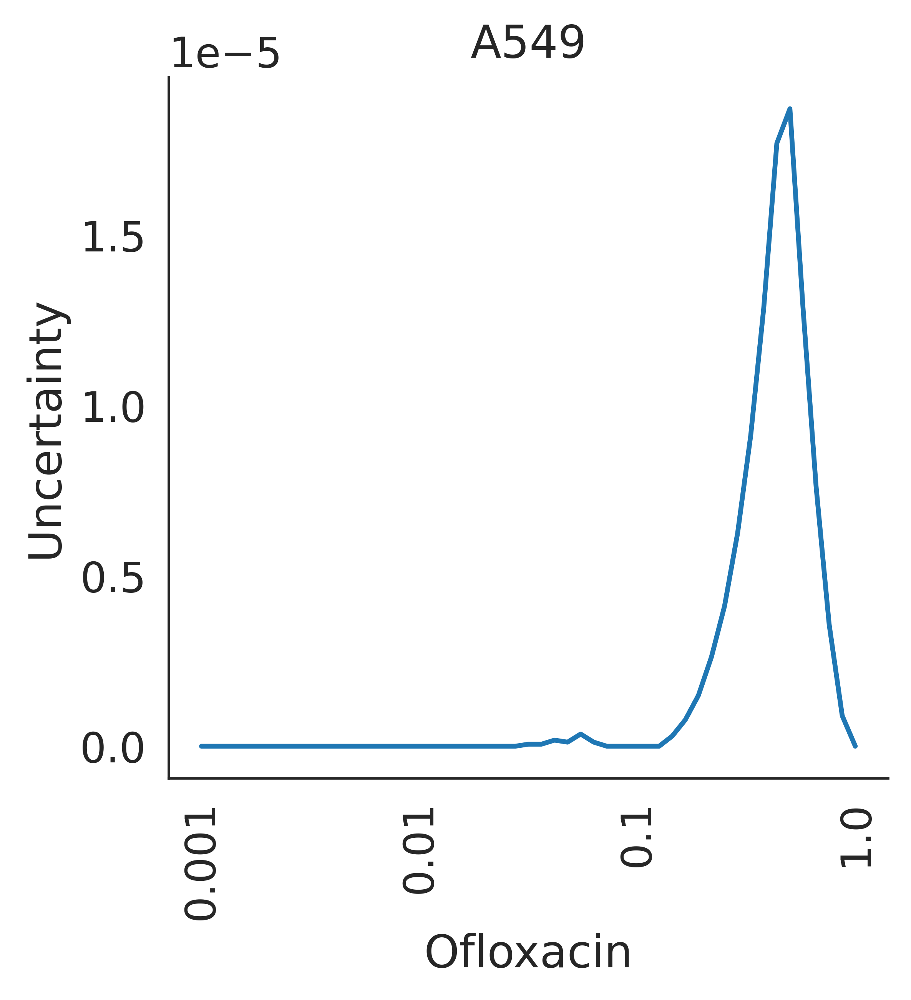

In [53]:
df_pred = pl.plot_uncertainty_dose(
    cpa_api,
    cov='A549',
    pert='Ofloxacin',
    N=51,
    measured_points=cpa_api.measured_points['all'],
    cond_key='condition',
    log=True,
    metric='cosine'
)

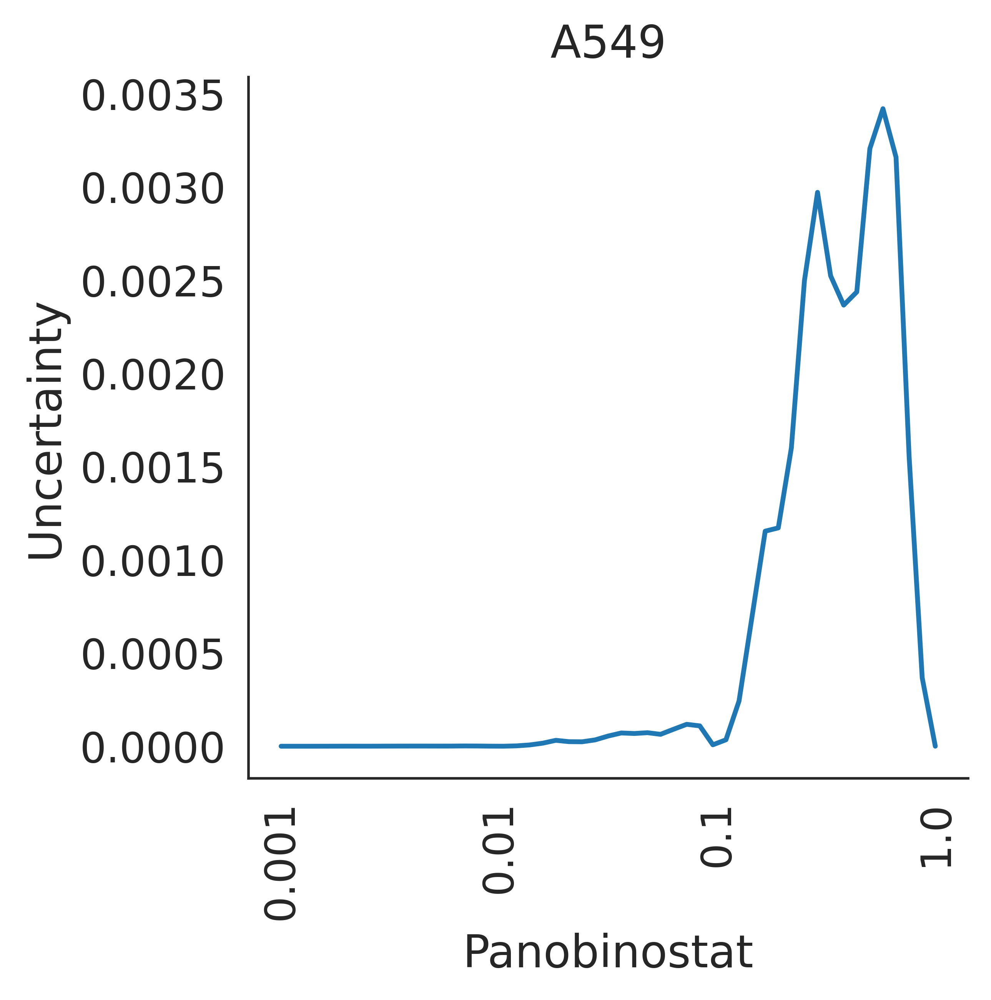

In [55]:
df_pred = pl.plot_uncertainty_dose(
    cpa_api,
    cov='A549',
    pert='Panobinostat',
    N=51,
    measured_points=cpa_api.measured_points['all'],
    cond_key='condition',
    log=True,
    metric='cosine'
)